# Part 2. Modelling the behavioral data

In Part 1, we had a look at options for preprocessing fMRI data. Now, let's turn to the other essential ingredient of model-based fMRI-analyses: modelling behavioral data.

There are Python packages that allows you to easily fit decision-making models such as the drift diffusion model (DDM). Most notably, [`hddm`](http://ski.clps.brown.edu/hddm_docs/) developed at Brown University is a widely used package.

However, `EMC` (as used in the tutorials earlier this week) has some advantages. For example, `EMC` offers much more models (including a multitude of LBA-model variants, racing diffusion models) and it offers a better sampler. So you might want to use `EMC` to fit a model, and then use `Nipype` to create your fMRI-processing pipeline.

So, we're just going to use `EMC` to fit the behavioral data for now. Note that _this_ notebook you're looking at right now (`Part 2. Modelling the behavioral data`) is actually _not_ an interactive Python notebook ('.ipynb'), but it is an interactive **R** notebook ('.irnb')! That means that instead of running Python code, we can run R-code in here.

For example, to draw some random numbers from a normal distribution (4,1), we can use this R-function:

[1] 3.357601 3.447711 5.414508 4.785032 4.260290 3.307530 4.733342 3.868952
 [9] 4.565404 3.078849

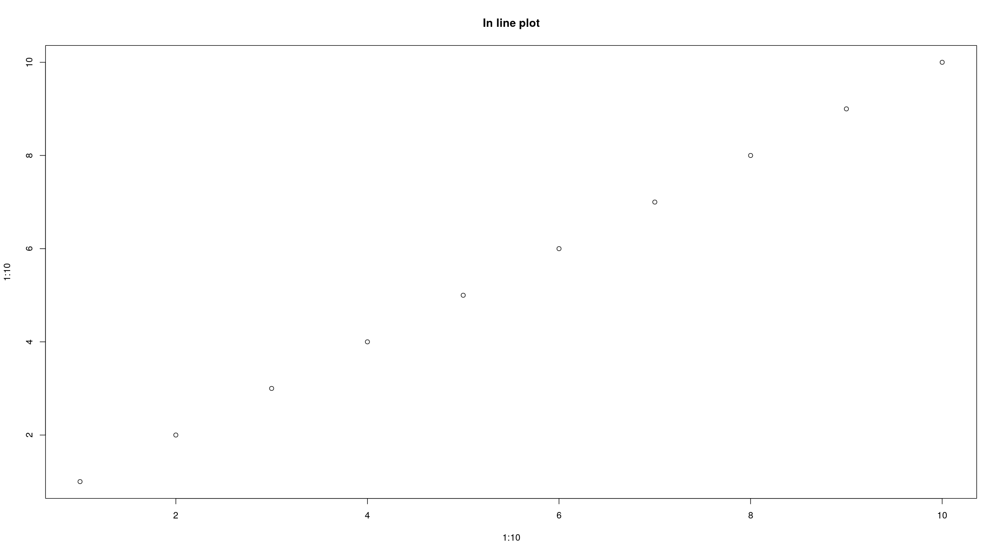

In [1]:
rnorm(10, 4, 1)

# note further that the help-function works as usual:
# ?rnorm

# this increases the plotting window size - this line only needs to be run once
options(repr.plot.width = 18, repr.plot.height = 10)

# and plotting is done in-line
plot(1:10, 1:10, main='In line plot')

### So let's use EMC to fit the behavioral data

First, set-up some directories, so R knows where to find EMC, the data, and where to store the results of these analyses (the 'res(ults)Dir')


In [2]:
## run this first once to set-up some thing for this server -- can forget about this
library(RhpcBLASctl)
omp_set_num_threads(1)
blas_set_num_threads(1)

In [3]:
projDir <- '/home/neuro/model_based_fmri'
dataDir <- file.path('/data', 'bids')
resDir <- file.path('/data', 'behavior_fits')
dir.create(resDir, showWarnings=FALSE)

# Load EMC
library(EMC2)

##### Load the data, and reformat to a EMC-approved form

In [4]:
# Load data
dat <- read.csv(file.path(dataDir, 'behavior.tsv'), sep='\t')

# Remove unnecessary columns, rename according to EMC's wishes
dat <- dat[,c('pp', 'cond', 'stimulus', 'response', 'RT')]
colnames(dat) <- c('subjects', 'E', 'S', 'R', 'rt')  # S = stimulus, E = emphasis, R = response, rt = response time

# Remove all extremely fast responses (<.15s)
dat <- dat[dat$rt>.15,]

# Ensure the following columns are of type factor
dat$subjects <- factor(dat$subjects)
dat$E <- factor(dat$E, levels=c('spd', 'acc'))
dat$S <- ifelse(dat$S=='stimright', 'right', 'left')
dat$S <- factor(dat$S, levels=c('left', 'right'))
dat$R <- factor(dat$R, levels=c('left', 'right'))

##### The next step is to set up the model specification

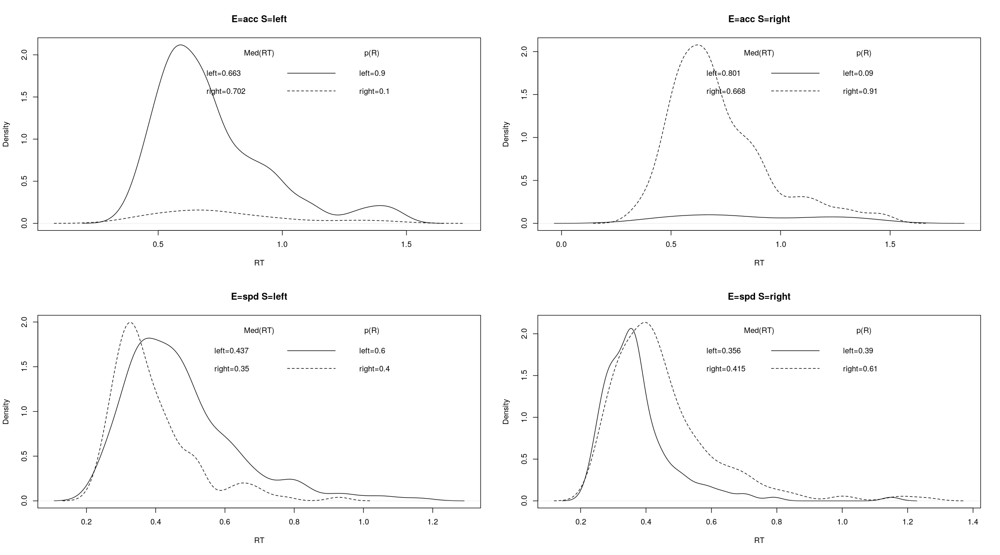

In [5]:
plot_defective_density(dat,factors=c('E', "S"),layout=c(2,2))

In [6]:
Emat <- matrix(c(-1,1),ncol=1)
dimnames(Emat) <- list(NULL,"acc-spd")     # estimate the contrast between ACC-SPD trials

# Average rate = intercept, and rate d = difference (match-mismatch) contrast
ADmat <- matrix(c(-1/2,1/2),ncol=1,dimnames=list(NULL,"d"))

### Next, we fit a series of models
Unfortunately the behavioral data in this dataset is rather limited in trial numbers (only 80).
As a result, models with more complexity than 1 parameter varying between SAT conditions, do not sample very well, rendering the resulting parameters rather unreliable.
Hence, here we just do a simple model comparison that compares three models that allow B, v, and t0 to vary between conditions respectively.
In the model that only allows B to vary between conditions, we further constrain `B_{spd}` to 0.05 and only estimate the contrast `B_Eacc-spd`; freely estimating `B_{spd}` also led to sampling issues.


In [ ]:
# convenience function to fit a model and return the samples and posterior predictives
fit_model <- function(data, design, fileName) {
    samplers <- make_samplers(data,design,type="standard",rt_resolution=.02)
    if(file.exists(fileName)) load(fileName)
    samplers <- run_emc(samplers, fileName=fileName, iter=5000, cores_per_chain=8, cores_for_chains=3, verbose=TRUE, verboseProgress=TRUE, max_trys = 20)
}

# Only B affected by E
design_B <- make_design(
  Ffactors=list(subjects=levels(dat$subjects),S=levels(dat$S),E=levels(dat$E)),
  Rlevels=levels(dat$R),matchfun=function(d)d$S==d$lR,
  Clist=list(lM=ADmat,lR=ADmat,S=ADmat,E=Emat),
  Flist=list(v~lM,sv~1,B~E,A~1,t0~1),       # <-- only B affected by E
  constants=c(sv=log(1), B=log(0.05)),
  model=lbaB)
fit_model(dat, design_B, "samples/sJoN_B.RData")

# Only v affected by E
design_v <- make_design(
  Ffactors=list(subjects=unique(dat$subjects),S=levels(dat$S),E=levels(dat$E)),
  Rlevels=levels(dat$R),matchfun=function(d)d$S==d$lR,
  Clist=list(lM=ADmat,lR=ADmat,S=ADmat,E=Emat),
  Flist=list(v~E+lM,sv~1,B~1,A~1,t0~1),     # <-- only v affected by E
  constants=c(sv=log(1)),
  model=lbaB)
fit_model(dat, design_v, "samples/sJoN_v.RData")


# only t0 affected by E
design_t0 <- make_design(
  Ffactors=list(subjects=unique(dat$subjects),S=levels(dat$S),E=levels(dat$E)),
  Rlevels=levels(dat$R),matchfun=function(d)d$S==d$lR,
  Clist=list(lM=ADmat,lR=ADmat,S=ADmat,E=Emat),
  Flist=list(v~lM,sv~1,B~1,A~1,t0~E),       # <-- only t0 affected by E
  constants=c(sv=log(1)),
  model=lbaB)
fit_model(dat, design_t0, "samples/sJoN_t0.RData")

         v      v_lMd B_Eacc-spd          A         t0 
         0          0          0          0          0 
attr(,"map")
attr(,"map")$v
    v v_lMd
35  1   0.5
171 1  -0.5

attr(,"map")$sv
   sv
35  1

attr(,"map")$B
   B B_Eacc-spd
35 1          1
1  1         -1

attr(,"map")$A
   A
35 1

attr(,"map")$t0
   t0
35  1



Processing data set 1

Likelihood speedup factor: 1.3 (1974 unique trials)

Running sample stage

Mean mpsrf= 1.003, Max alpha mpsrf/psrf = 1.016

1: Iterations sample = 2400

Mean mpsrf= 1.003, Max alpha mpsrf/psrf = 1.012

2: Iterations sample = 2500

Mean mpsrf= 1.002, Max alpha mpsrf/psrf = 1.01

3: Iterations sample = 2600

Mean mpsrf= 1.002, Max alpha mpsrf/psrf = 1.011

4: Iterations sample = 2700

Mean mpsrf= 1.002, Max alpha mpsrf/psrf = 1.012

5: Iterations sample = 2800

Mean mpsrf= 1.002, Max alpha mpsrf/psrf = 1.012

6: Iterations sample = 2900

Mean mpsrf= 1.002, Max alpha mpsrf/psrf = 1.012

7: Iterations sample = 3000

Mean mpsrf= 1.002, Max alpha mpsrf/psrf = 1.01

8: Iterations sample = 3100

Mean mpsrf= 1.002, Max alpha mpsrf/psrf = 1.009

9: Iterations sample = 3200

Mean mpsrf= 1.002, Max alpha mpsrf/psrf = 1.009



##### Sampling can take a bit of time, so I ran these models in advance, so you can just load the samplers & posterior predictives

In [7]:
print(load('./samples/sJoN_B.RData'))
sJoN_B <- samplers

print(load('./samples/sJoN_v.RData'))
sJoN_v <- samplers

print(load('./samples/sJoN_t0.RData'))
sJoN_t0 <- samplers

[1] "samplers"
[1] "samplers"
[1] "samplers"


# Model comparison
Let's start by doing a very basic model comparison based on information criteria (BPIC and DIC)

In [15]:
compare_IC(list(B=sJoN_B,
                v=sJoN_v,
                t0=sJoN_t0))

    DIC wDIC BPIC wBPIC EffectiveN meanD Dmean minD
B  -251    1 -152     1         99  -350  -405 -450
v   134    0  292     0        158   -24   -43 -182
t0   94    0  235     0        141   -46   -56 -187


Of these three models, the threshold-only model clearly wins both according to the DIC and BPIC.

# Did sampling go well?
Let's then assume the threshold-only model is the best model. What do the chains of the corresponding sampler look like?

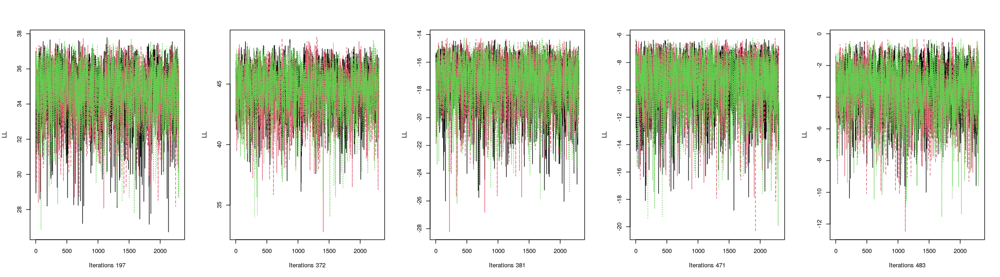

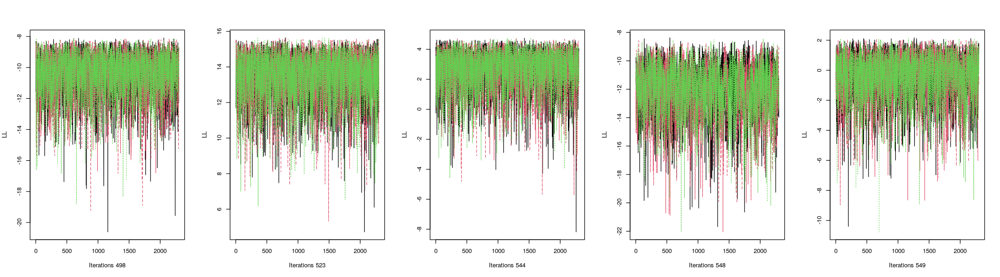

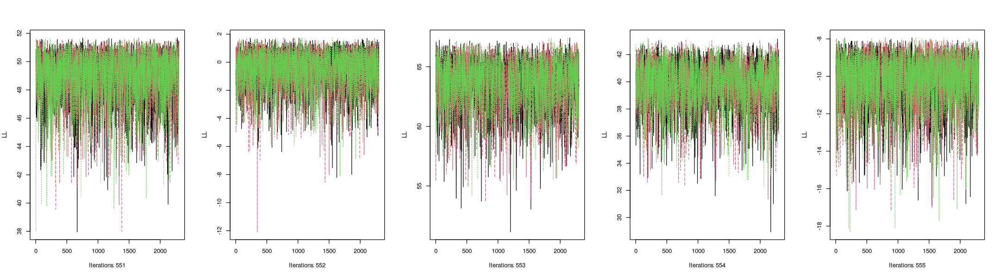

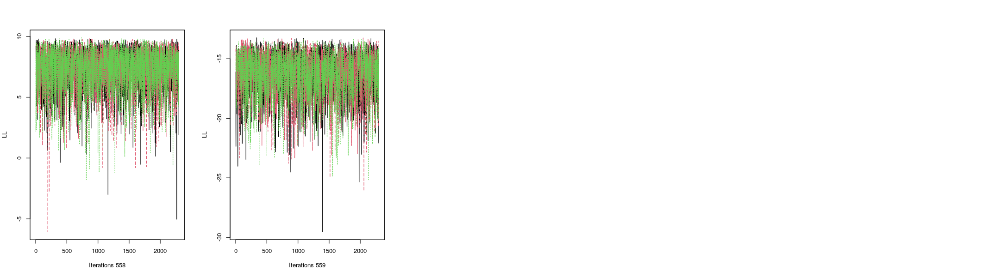

In [16]:
options(repr.plot.width = 18, repr.plot.height = 5)  # here we adjust the plotting area in jupyter; you can adjust the width and height if this doesn't fit your screen well.
plot_chains(sJoN_B, selection='LL', layout=c(1,5))   # this actually plots; i.c. the posterior log likelihoods per subject

The LL plots look like "big hairy caterpillars", as intended, so that's good. Next we can check the posteriors of the parameters at the subject level (alpha)

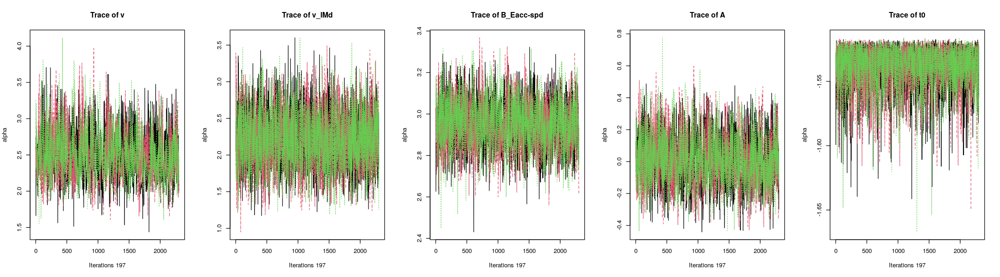

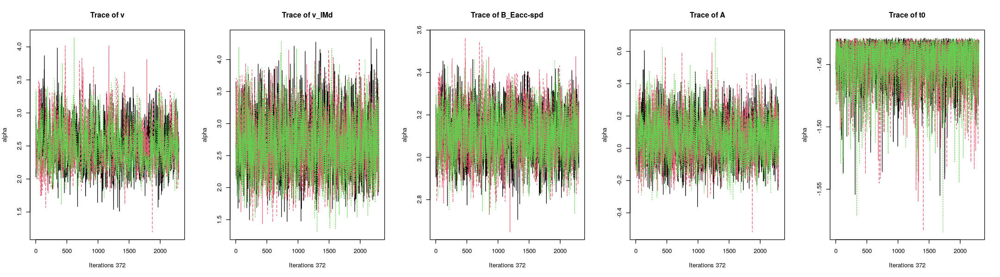

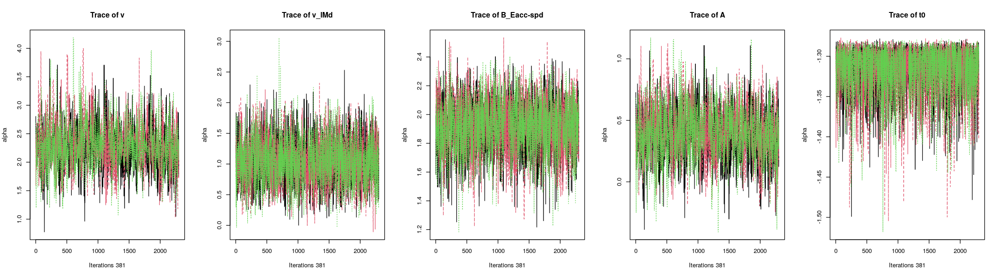

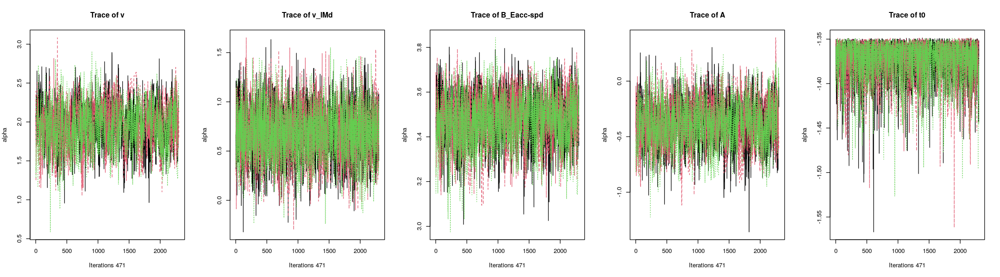

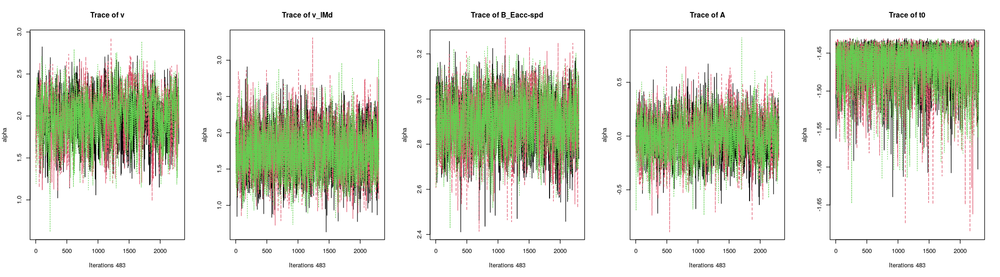

...

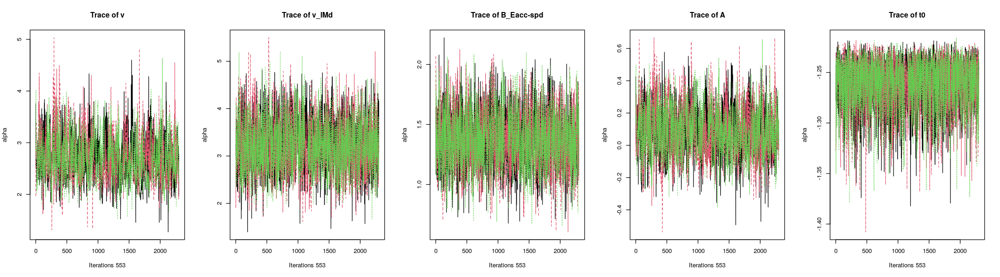

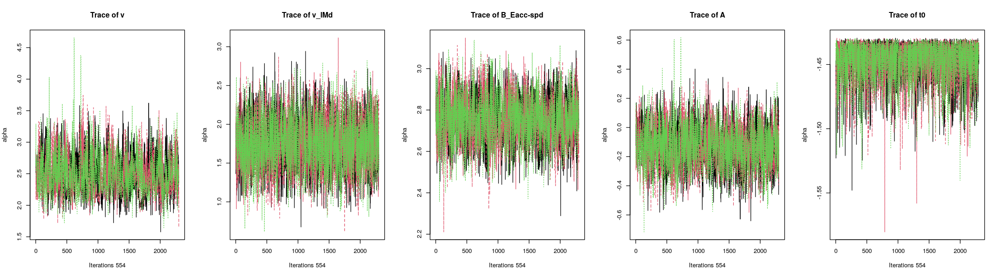

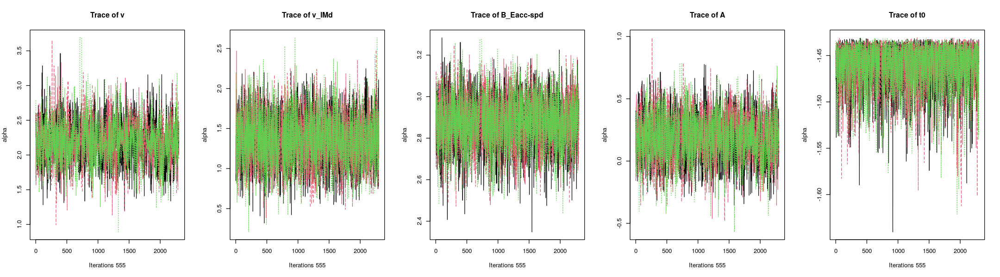

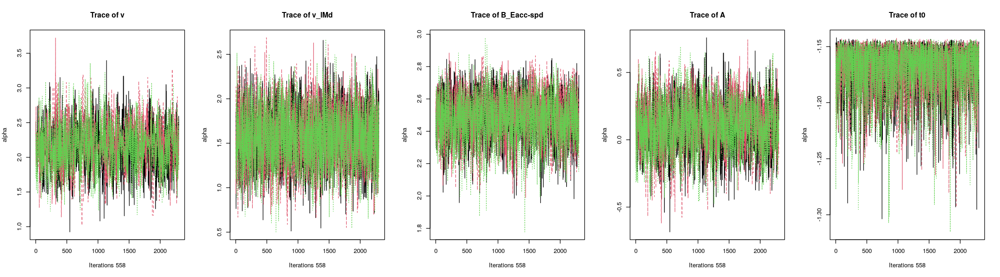

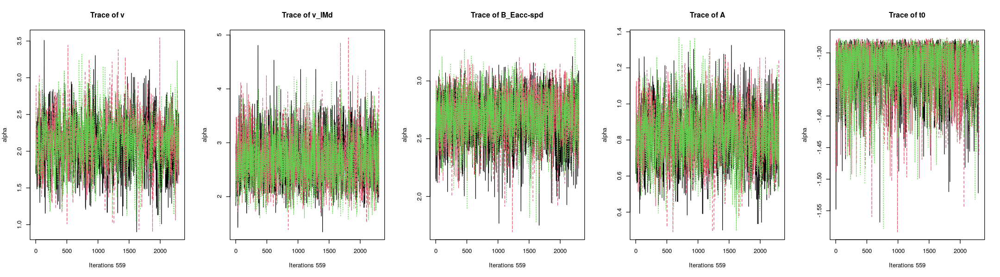

In [17]:
plot_chains(sJoN_B, selection='alpha', layout=c(1,5))

Generally, `t0`, `v_lMd`, and `B_Eacc-spd` seem fine. `v` and `A` seem to sample a bit worse, the shapes suggest autocorrelations. What about the population level?

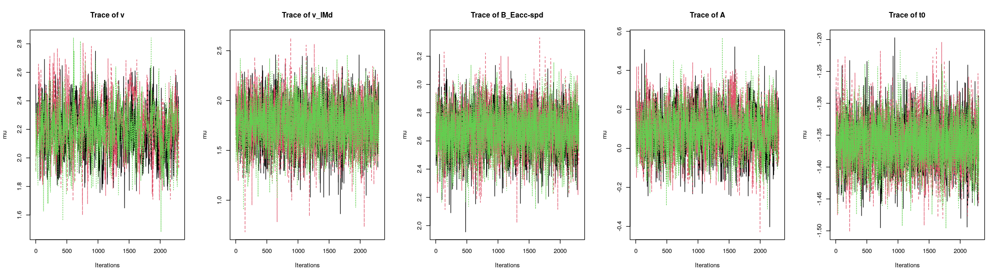

In [18]:
plot_chains(sJoN_B, selection='mu', layout=c(1,5))

That looks a bit similar for `v` as in the subject level. 

So let's check out how autocorrelated the chains arse. How many effective samples do we have, and how efficient are we sampling?

In [20]:
EMC2:::iat_pmwg(sJoN_B)

        t0      v_lMd B_Eacc-spd          A          v 
      1.49       1.89       3.05       4.48       7.06 


In [21]:
EMC2:::es_pmwg(sJoN_B)

EMC2:::es_pmwg(sJoN_B, summary_alpha = 'min')

         v          A B_Eacc-spd      v_lMd         t0 
      1174       1760       2417       4137       4837 
         v          A B_Eacc-spd      v_lMd         t0 
       616        874       1342       2365       3499 


So we have at least 616 samples for `v` and 874 for `A`, which isn\'t super high but should work. `A` and `v` also show lowest estimation efficiency.

How well did the chains mix? Are we sure that the chains converged (so that we've been sampling from the posterior)? These numbers should all be close to 1; numbers higher than (say) 1.05 indicate poor mixing and that chains might not have fully converged. The cut-off of 1.05 is a bit arbitrarily chosen here though, there's other numbers reported in the literature.

In [23]:
round(EMC2:::gd_pmwg(sJoN_B,selection="alpha"),2) 

 554  372  197  551  553  555  552  544  483  523  549  558  471  498  559  381 
1.00 1.00 1.00 1.00 1.00 1.00 1.00 1.00 1.00 1.01 1.01 1.01 1.01 1.01 1.01 1.01 
 548 
1.01 


,v,v_lMd,B_Eacc-spd,A,t0,mpsrf
197,1.00,1,1.00,1.00,1,1.00
372,1.00,1,1.00,1.00,1,1.00
381,1.01,1,1.00,1.01,1,1.01
471,1.01,1,1.01,1.00,1,1.01
483,1.01,1,1.00,1.00,1,1.00
498,1.01,1,1.00,1.01,1,1.01
523,1.00,1,1.00,1.00,1,1.01
544,1.01,1,1.00,1.00,1,1.00
548,1.01,1,1.00,1.02,1,1.01
549,1.01,1,1.00,1.00,1,1.01


In [24]:
round(EMC2:::gd_pmwg(sJoN_B,selection="mu"),2) 

[1] 1.01


v      v_lMd B_Eacc-spd          A         t0      mpsrf 
      1.01       1.00       1.00       1.01       1.00       1.01

Certainly no issues here, very good mixing.

# Fits
Next, let's visualize how well this model actually fits the data. E.g., are there any obvious misfits? Does the model generally describe the data well? Can it capture the difference between SAT conditions?

In [8]:
ppJoN_B <- post_predict(sJoN_B, n_cores=19)

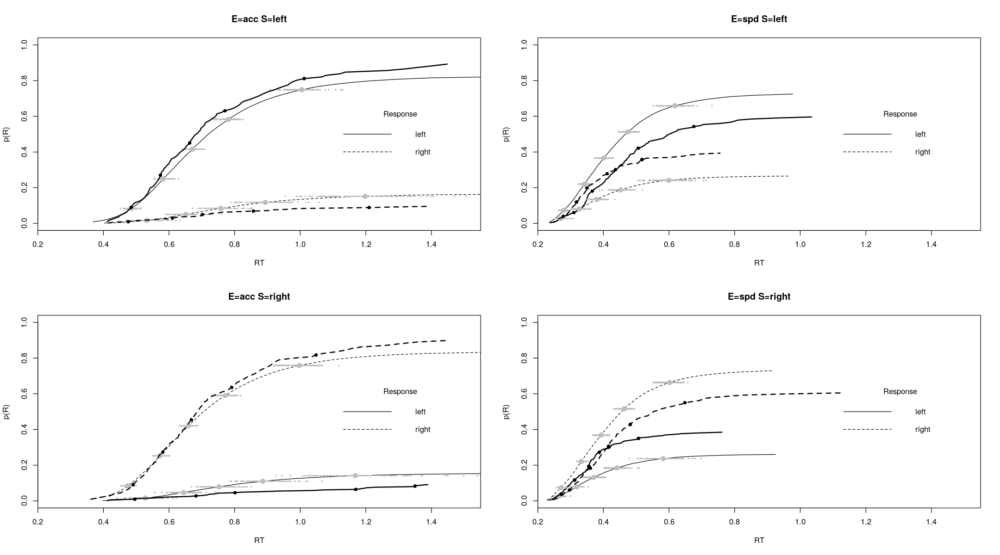

In [9]:
options(repr.plot.width = 18, repr.plot.height = 10)                                    # change plotting area size a bit again
plot_fit(dat,ppJoN_B,layout=c(2,2),factors=c("E","S"),lpos="right",xlim=c(.25,1.5))     # aggregate over subjects and plot 'overall' CDFs

The overall (across-subject) fit seem to look reasonable (but not great). The model seems to capture the median/mean RTs and accuracy okay. Note that individual fits look a lot worse:

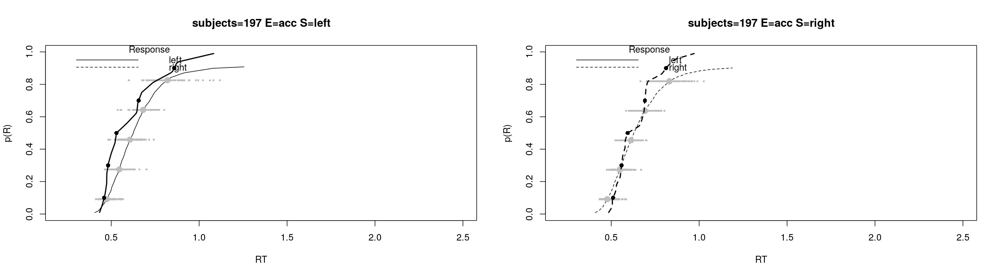

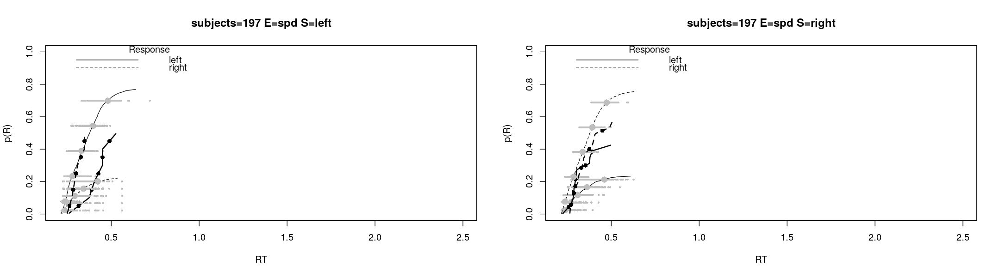

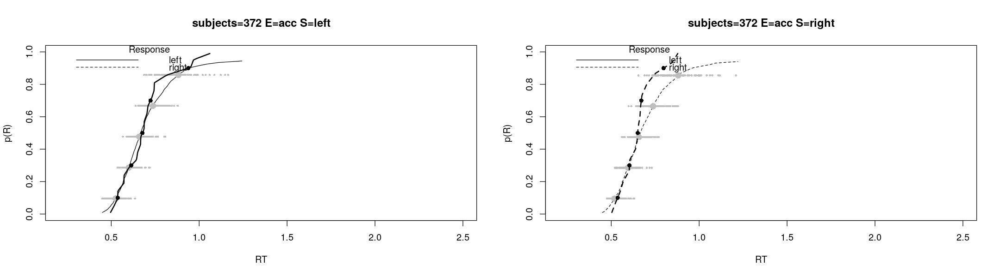

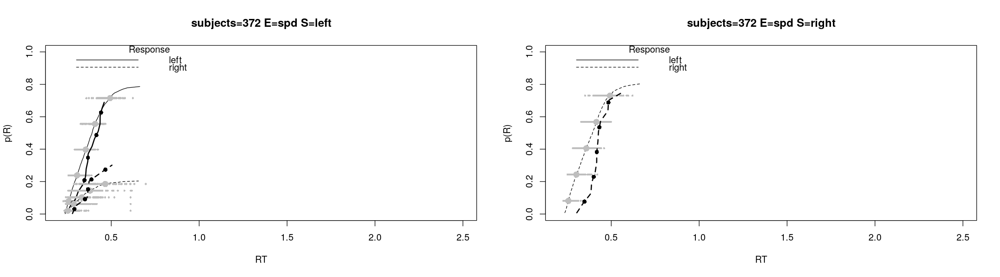

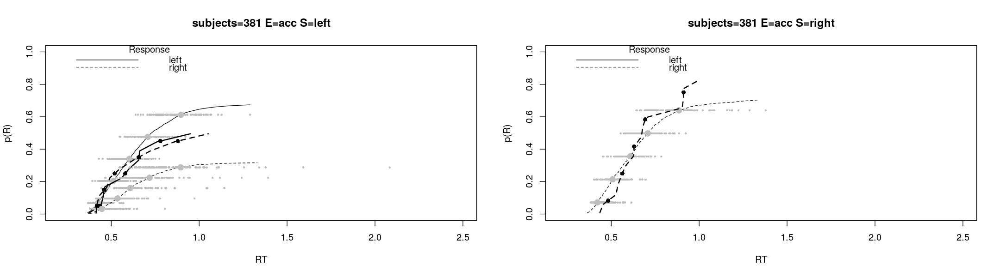

...

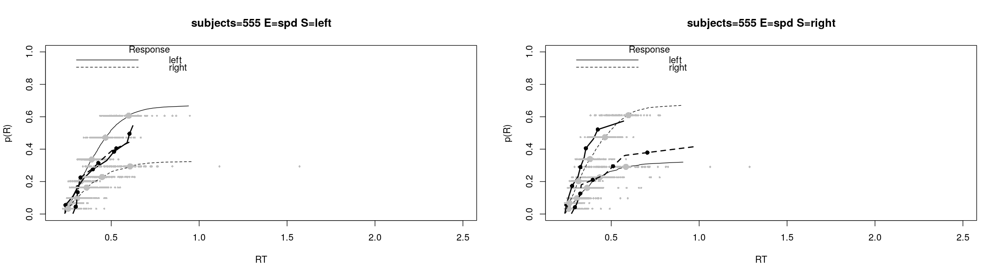

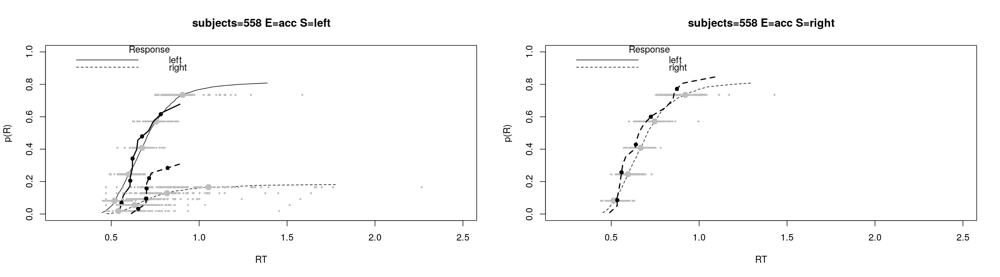

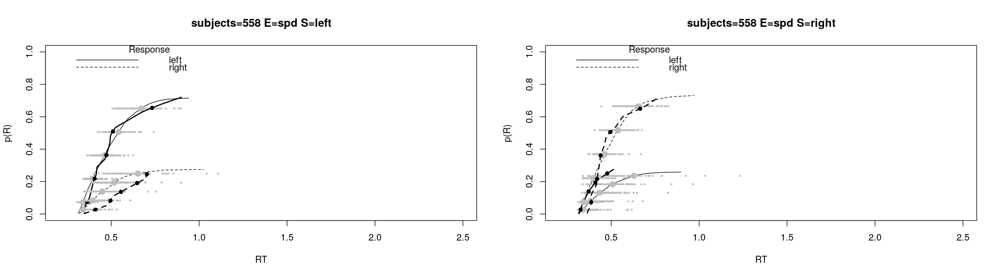

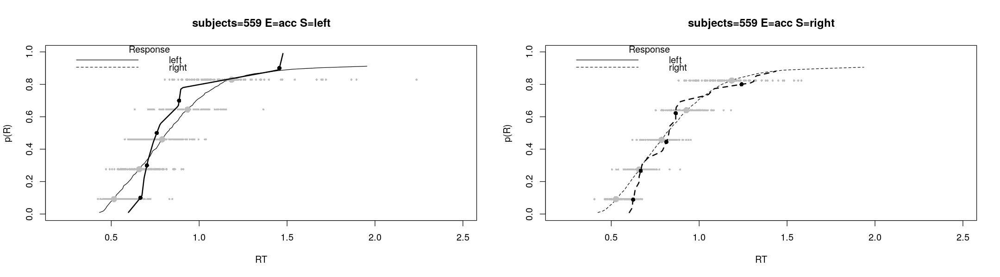

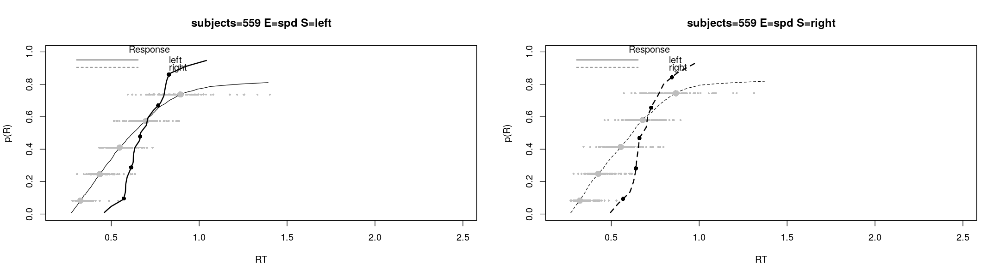

In [14]:
options(repr.plot.width = 18, repr.plot.height = 5)                              #  
plot_fit(dat, ppJoN_B, layout=c(1,2), factors=c("subjects", "E", "S"))           # plot by subject

Given the limited amount of behavioral data, this is to be expected. Most importantly for the purposes of the current tutorial is that the SAT manipulation seems to be captured reasonably well by the threshold contrast `B_Eacc-spd`

# What about the parameters? 
Is `B_Eacc-spd` 'significant' at the population level? Let's first just visualize the posteriors

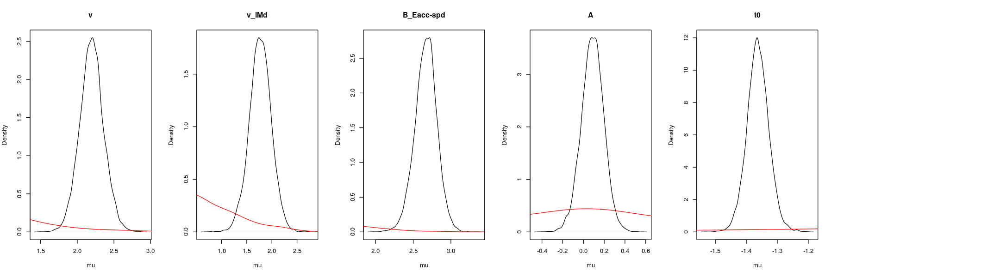

In [15]:
plot_density(sJoN_B,layout=c(1,6),selection="mu")  # on the log scale. 
# Note that the red lines are the priors, so we can see here that the posteriors really updated (ie we didn't just sample from the prior)

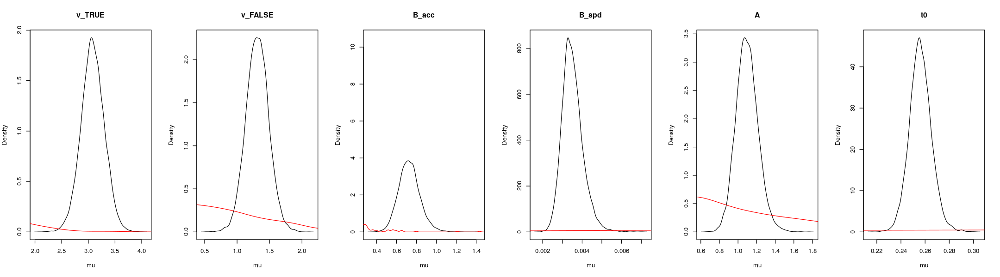

In [16]:
plot_density(sJoN_B,layout=c(1,6),selection="mu", mapped=TRUE)   
# 'final' parameters on the natural scale

We can also calculate the proportion of density above/below 0 for the `B_Eacc-spd` parameter

In [17]:
p_test(x=sJoN_B,x_name="B_Eacc-spd", probs = c(.001, 0.025, 0.5, 0.975, .999)) 

Warning message in cbind(quantile(x, probs), c(NA, mu, NA)):
“number of rows of result is not a multiple of vector length (arg 2)”


      B_Eacc-spd mu
0.1%        2.12 NA
2.5%        2.37  0
50%         2.67 NA
97.5%       2.95 NA
99.9%       3.14  0
attr(,"less")
[1] 0


So pretty much the entire posterior lies above 0, indicating that there is an effect

# In sum
we have a model that: 
- wins simple model comparison, 
- shows reasonably good sampling properties, 
- fits the behavioral data reasonably well, and 
- shows a between-condition contrast in the threshold parameter, captured by `B_Eacc-spd`

For the model-based fMRI analyses, we need the individual subject threshold-difference values (`B_Eacc-spd`), so let's extract these and save

In [18]:
parameters = parameters_data_frame(sJoN_B, mapped=TRUE, selection="alpha")

median_parameters = aggregate(.~subjects, parameters, median)   # this calculates all parameters' median by subject
median_parameters                                               # Note that all parameters except v are on a log scale! so let's trasnform to natural scale

# and save
write.csv(median_parameters, file=file.path(resDir, 'parameters_per_subject_lba_B_emc_group.csv'))

subjects,v_TRUE,v_FALSE,B_acc,B_spd,A,t0
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
197,3.557803,1.3690493,0.9552764,0.002617044,1.0037951,0.2160226
372,3.811266,1.1424519,1.1222589,0.002227650,1.0610979,0.2366033
381,2.761378,1.7345863,0.3432259,0.007283832,1.4657452,0.2706130
471,2.332425,1.6356135,1.6379034,0.001526342,0.6946895,0.2552843
483,2.862264,1.1338855,0.9123059,0.002740309,0.9914559,0.2328944
498,2.632773,1.5702030,0.6624802,0.003773698,1.1328628,0.2521157
523,3.229652,1.2481527,0.9350510,0.002673651,1.1127323,0.2349654
544,3.210357,1.1175975,0.8887751,0.002812860,1.2665381,0.2342812
548,2.580278,1.2065377,0.8256882,0.003027777,0.9506386,0.2922441


In [19]:
median_parameters

subjects,v_TRUE,v_FALSE,B_acc,B_spd,A,t0
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
197,3.557803,1.3690493,0.9552764,0.002617044,1.0037951,0.2160226
372,3.811266,1.1424519,1.1222589,0.002227650,1.0610979,0.2366033
381,2.761378,1.7345863,0.3432259,0.007283832,1.4657452,0.2706130
471,2.332425,1.6356135,1.6379034,0.001526342,0.6946895,0.2552843
483,2.862264,1.1338855,0.9123059,0.002740309,0.9914559,0.2328944
498,2.632773,1.5702030,0.6624802,0.003773698,1.1328628,0.2521157
523,3.229652,1.2481527,0.9350510,0.002673651,1.1127323,0.2349654
544,3.210357,1.1175975,0.8887751,0.002812860,1.2665381,0.2342812
548,2.580278,1.2065377,0.8256882,0.003027777,0.9506386,0.2922441
